## SDXL model

installations

In [1]:
%pip install --upgrade diffusers[torch]
%pip install invisible_watermark transformers accelerate safetensors
%pip install --upgrade huggingface_hub[cli]

  Using cached diffusers-0.19.3-py3-none-any.whl (1.3 MB)
  Using cached safetensors-0.3.1-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (1.3 MB)
     |████████████████████████████████| 772 kB 21.0 MB/s eta 0:00:01
     |████████████████████████████████| 17.3 MB 70.9 MB/s eta 0:00:01
     |████████████████████████████████| 3.3 MB 58.6 MB/s eta 0:00:01
     |████████████████████████████████| 268 kB 68.6 MB/s eta 0:00:01
     |████████████████████████████████| 619.9 MB 7.1 kB/s  eta 0:00:01     |██████████████▍                 | 278.4 MB 59.0 MB/s eta 0:00:06     |█████████████████▏              | 332.1 MB 91.0 MB/s eta 0:00:04��████████████▌           | 397.9 MB 66.9 MB/s eta 0:00:04     |█████████████████████████████▌  | 570.7 MB 97.7 MB/s eta 0:00:01
  Using cached accelerate-0.21.0-py3-none-any.whl (244 kB)
     |████████████████████████████████| 163 kB 76.0 MB/s eta 0:00:01
     |████████████████████████████████| 77 kB 6.2 MB/s  eta 0:00:01
     |█████████████████████████

     |████████████████████████████████| 173.2 MB 16 kB/s s eta 0:00:01    |███████████████▎                | 82.5 MB 67.0 MB/s eta 0:00:02     |████████████████                | 87.1 MB 84.3 MB/s eta 0:00:02        | 121.1 MB 84.3 MB/s eta 0:00:01��████████████████████████▌   | 154.4 MB 84.3 MB/s eta 0:00:01
     |████████████████████████████████| 849 kB 64.2 MB/s eta 0:00:01
     |████████████████████████████████| 54.6 MB 152 kB/s  eta 0:00:01              | 276 kB 66.0 MB/s eta 0:00:01
     |████████████████████████████████| 102.6 MB 1.8 kB/s  eta 0:00:01    |█████████████▍                  | 42.8 MB 73.9 MB/s eta 0:00:01     |████████████████████████████    | 90.1 MB 91.0 MB/s eta 0:00:01     |██████████████████████████████▏ | 96.8 MB 91.0 MB/s eta 0:00:01
     |████████████████████████████████| 2.1 MB 75.4 MB/s eta 0:00:01
     |████████████████████████████████| 21.0 MB 115 kB/s  eta 0:00:01
     |████████████████████████████████| 5.7 MB 22.5 MB/s eta 0:00:01     |█████████████████

imports

In [2]:
from diffusers import DiffusionPipeline, StableDiffusionXLPipeline
import torch
from IPython.display import display, Image

inference using SDXL model

Example of a **Midjourney** prompt used to generate one of the sample images : 

"Generate a highly realistic and detailed image of the inside of a dishwasher mid-cycle. Add realistic water splashes and droplets to create a dynamic and immersive depiction of the cleaning process. Focus on the action of water jets and detergent as they work together to clean the dishes, visibly demonstrating food stains being removed from the dishes. Include a variety of dishes strategically placed inside, such as plates, cutlery, and glasses, to illustrate the dishwasher's loading capacity. Emphasize the efficiency and effectiveness of the cleaning process, while prominently featuring a physical dishwasher tablet product in action. Use your advanced 3D imaging capabilities to bring this hidden process to life with accuracy and detail."

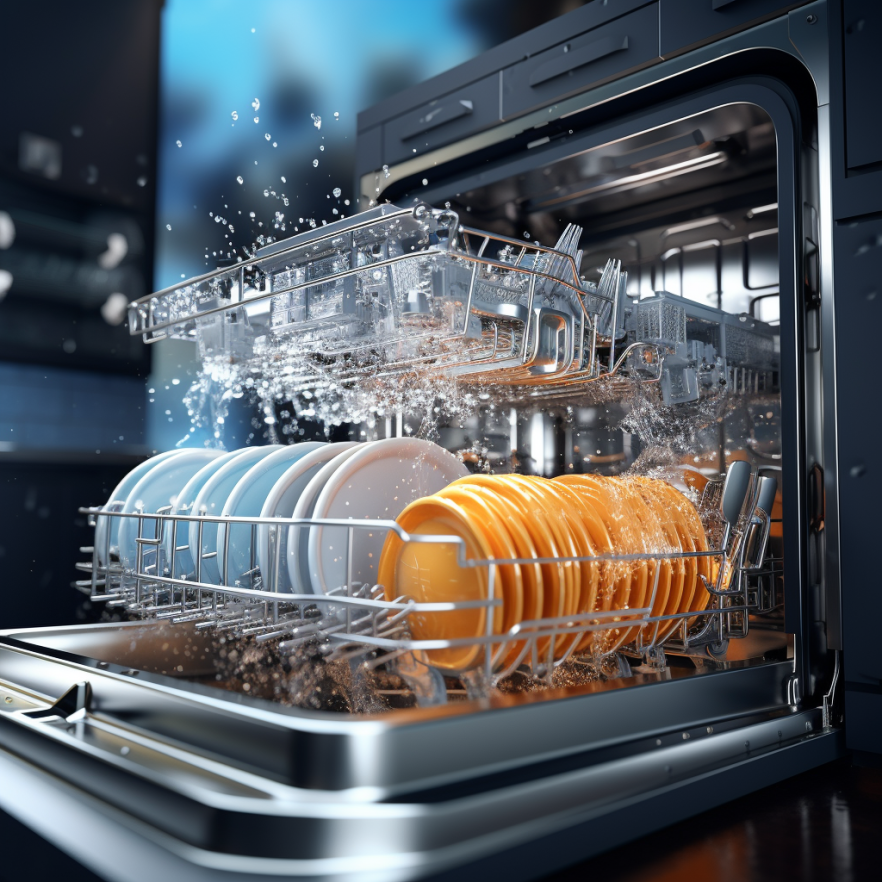

In [10]:
Image(filename='midjourney.png')


Refined prompt for **Stable Diffusion** (derived from ChatGPT) - max 77 token limit:

"Generate a realistic dishwasher mid-cycle image. Showcase water splashes, effective cleaning, and our powerful tablet product. Highlight spotless results, promoting our brand's superiority."

In [3]:
# pipeline = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-0.9", torch_dtype=torch.float16, use_safetensors=True, variant="fp16")
# pipeline.to("cuda")

base = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True)
base.enable_model_cpu_offload()

Loading pipeline components...: 100%|██████████| 7/7 [00:07<00:00,  1.14s/it]


In [4]:
img_1_0 = base("Inside a dishwasher mid-cycle, door closed, birds eye view from inside the door, dishes, food stains lifting, water, cleaning process").images[0]

100%|██████████| 50/50 [01:38<00:00,  1.97s/it] 


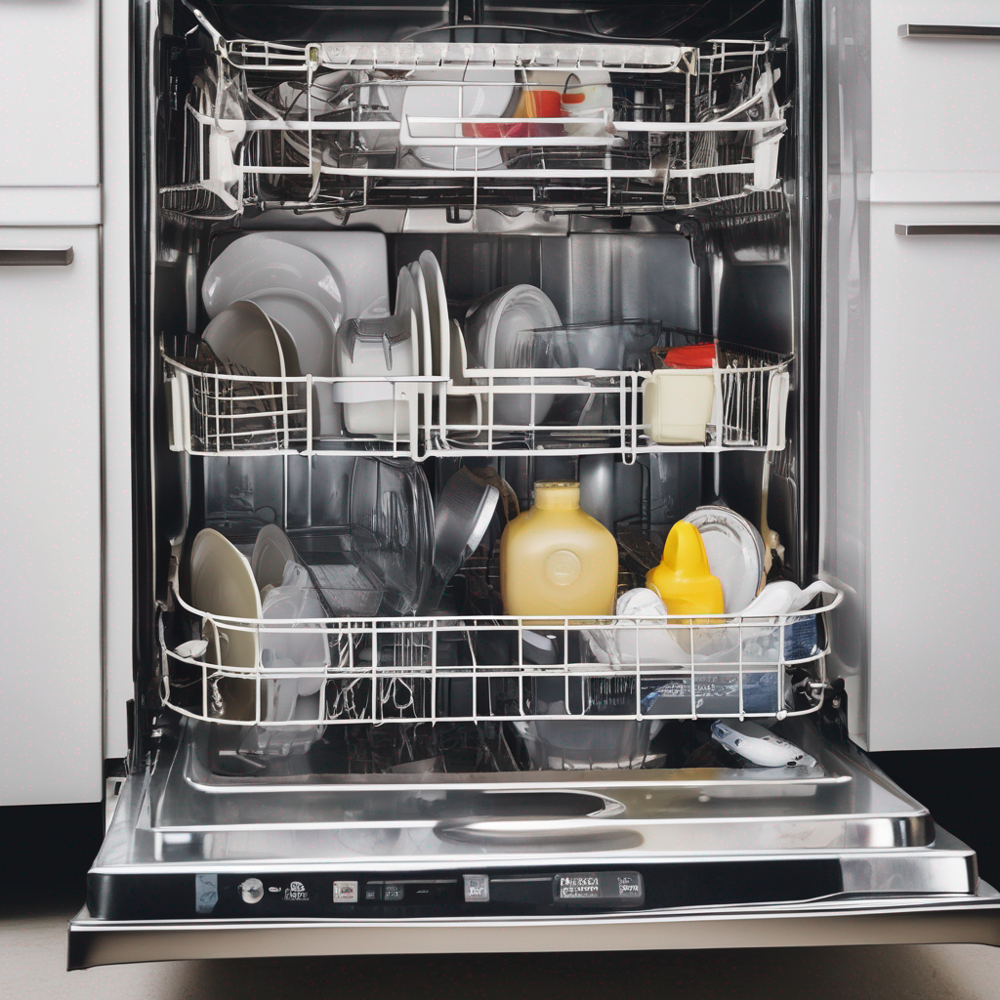

In [5]:
display(img_1_0)

In [6]:
img = base("Generate a realistic dishwasher mid-cycle image. Showcase water splashes, effective cleaning, and our powerful tablet product. Highlight spotless results, promoting our brand's superiority.").images[0]

100%|██████████| 50/50 [00:15<00:00,  3.23it/s]


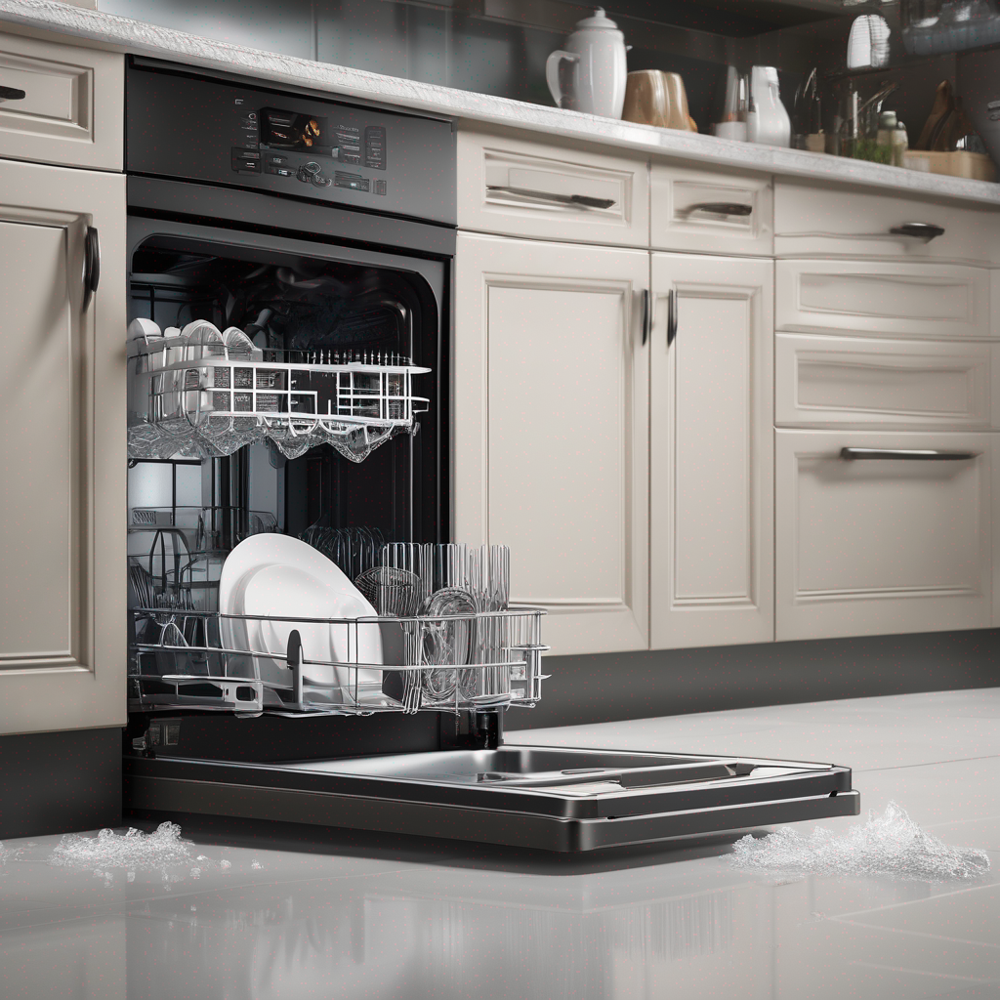

In [7]:
display(img)

In [8]:
img2 = base("Generate a realistic dishwasher mid-cycle image. Showcase water splashes, effective cleaning, and our powerful tablet product. Highlight spotless results, promoting our brand's superiority.").images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [00:15<00:00,  3.26it/s]


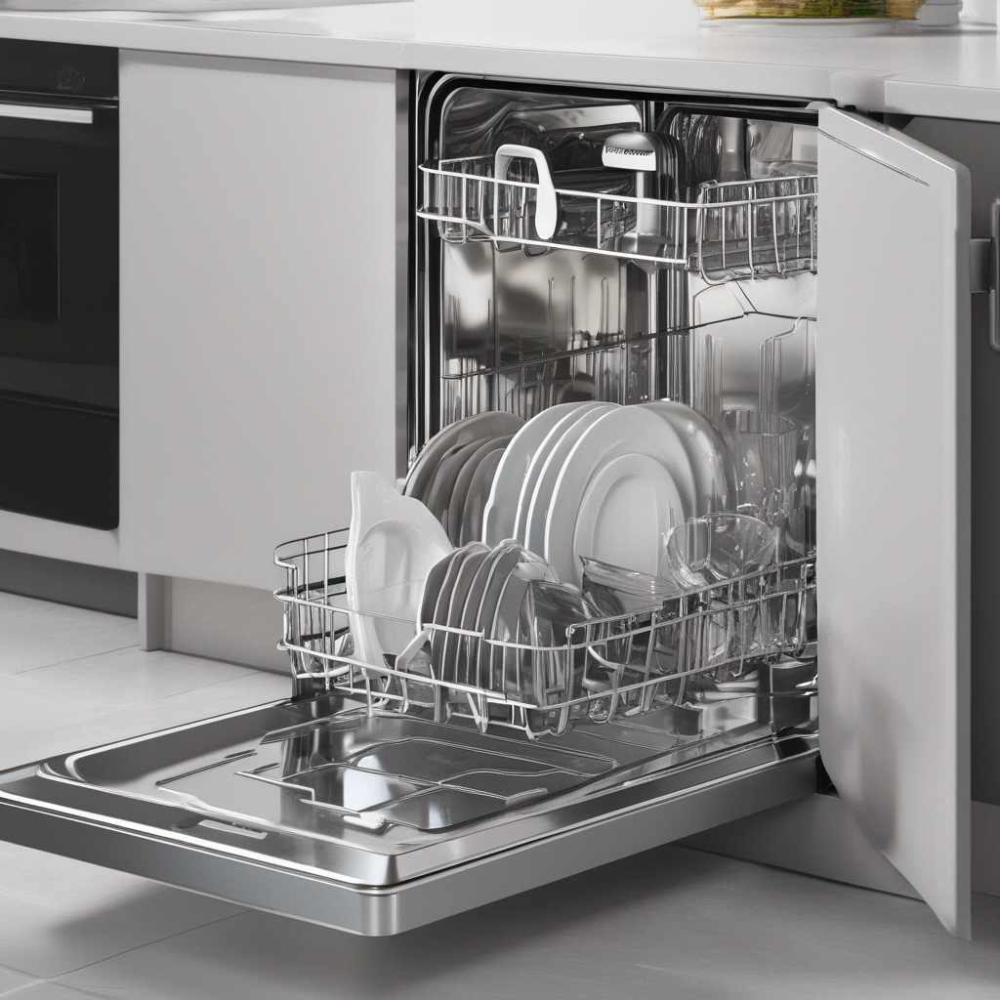

In [9]:
display(img2)

In [24]:
def sdxl(prompt):
    img = base(prompt).images[0]
    display(img)

100%|██████████| 50/50 [00:15<00:00,  3.28it/s]


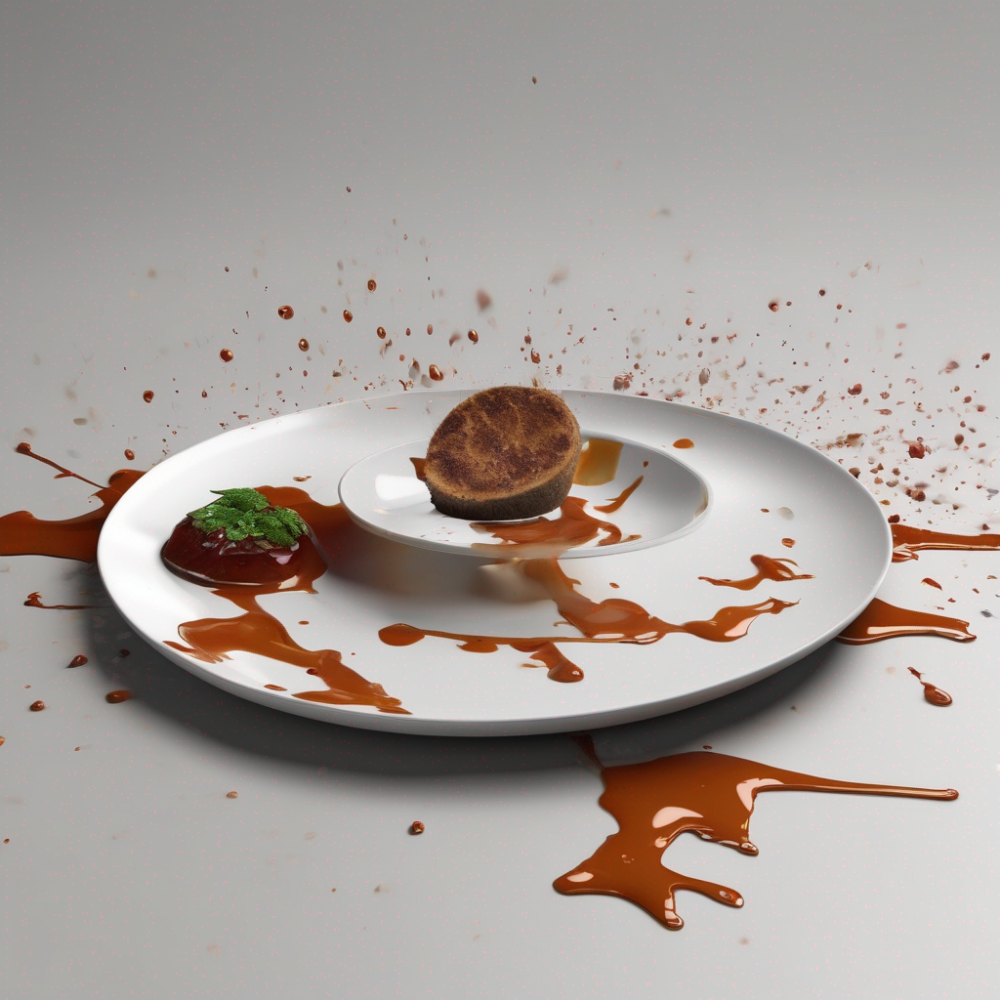

In [11]:
sdxl("Generate an image of a single plate with lifted food stains, being blown off as a result of a dish cleaning process. Showcase realistic and inventive details.")

100%|██████████| 50/50 [00:15<00:00,  3.30it/s]


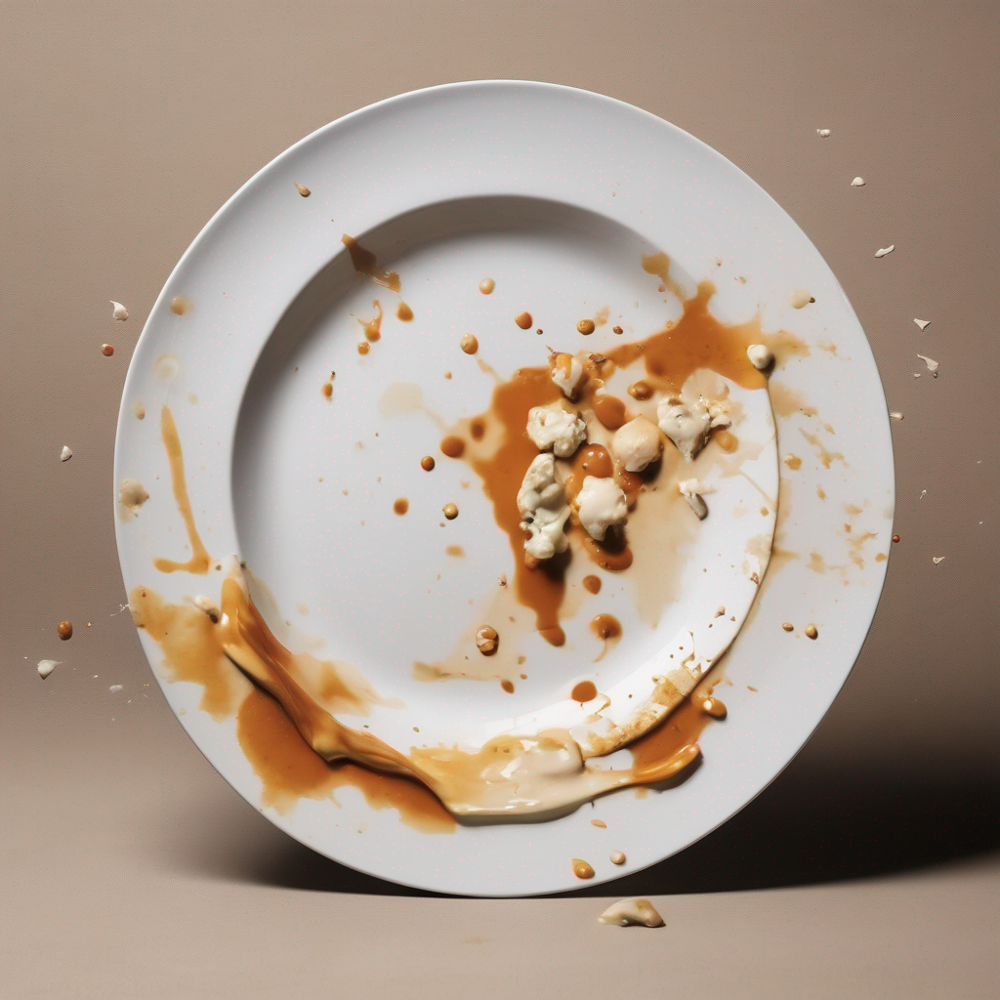

In [12]:
sdxl("single plate, food stains, splatters of food stains being blown off the plate")

100%|██████████| 50/50 [00:15<00:00,  3.28it/s]


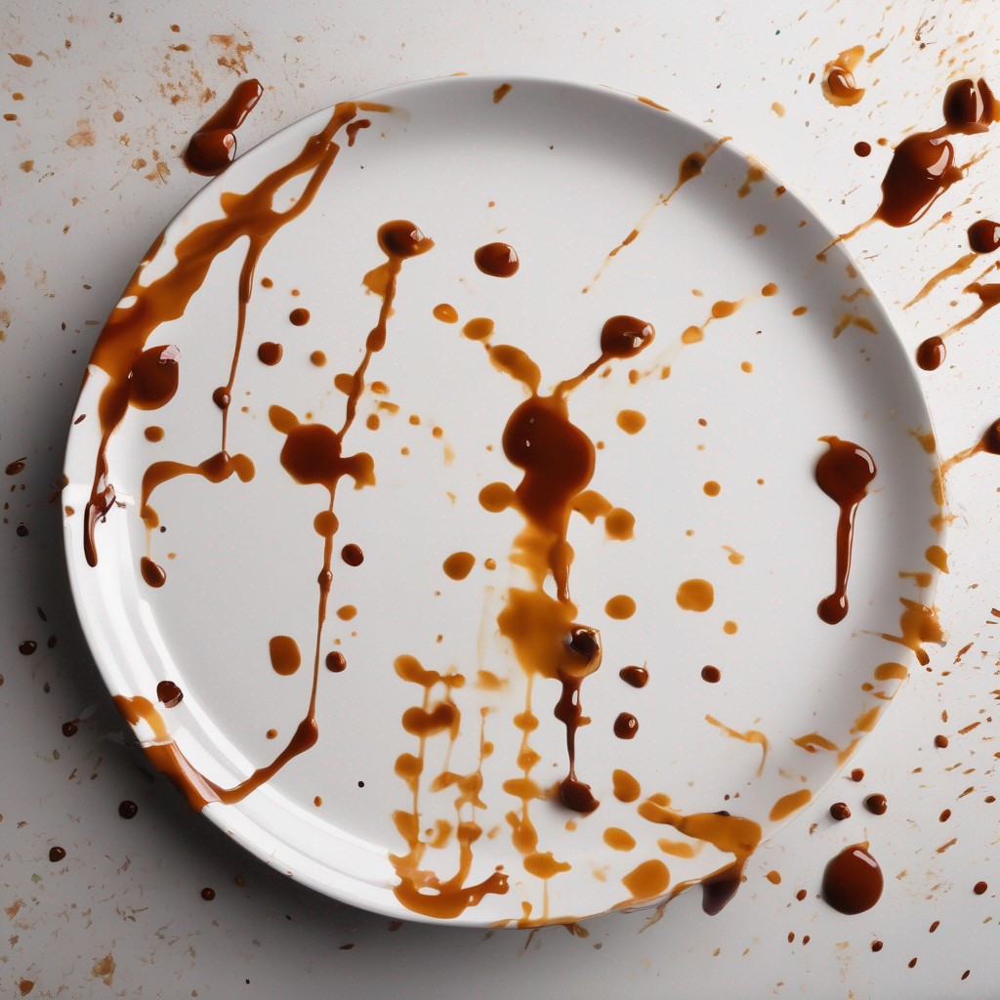

In [13]:
sdxl("single plate laying horizontally, food stains, lots of splatters of food stains being blown off the plate")

100%|██████████| 50/50 [00:15<00:00,  3.28it/s]


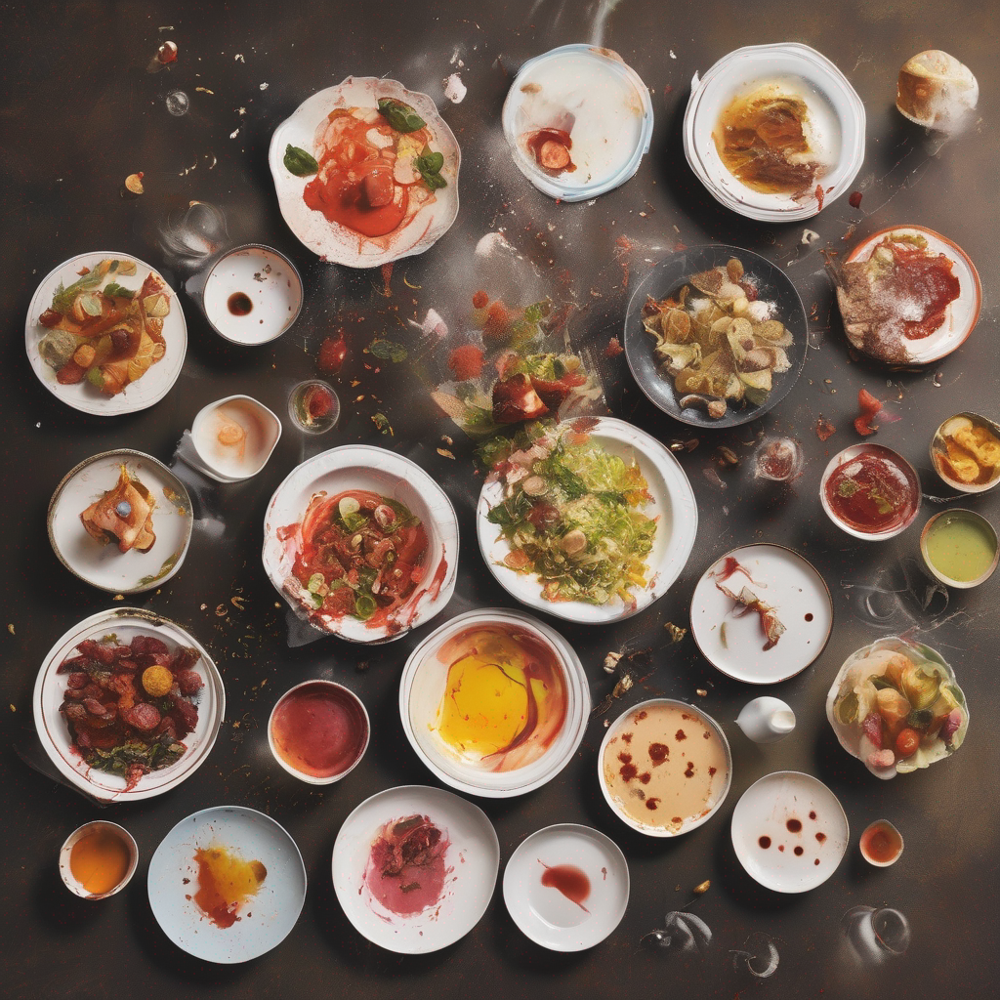

In [14]:
sdxl("variety of dishes on a table, food stains, splatters of food being blown off the dishes")

100%|██████████| 50/50 [00:15<00:00,  3.33it/s]


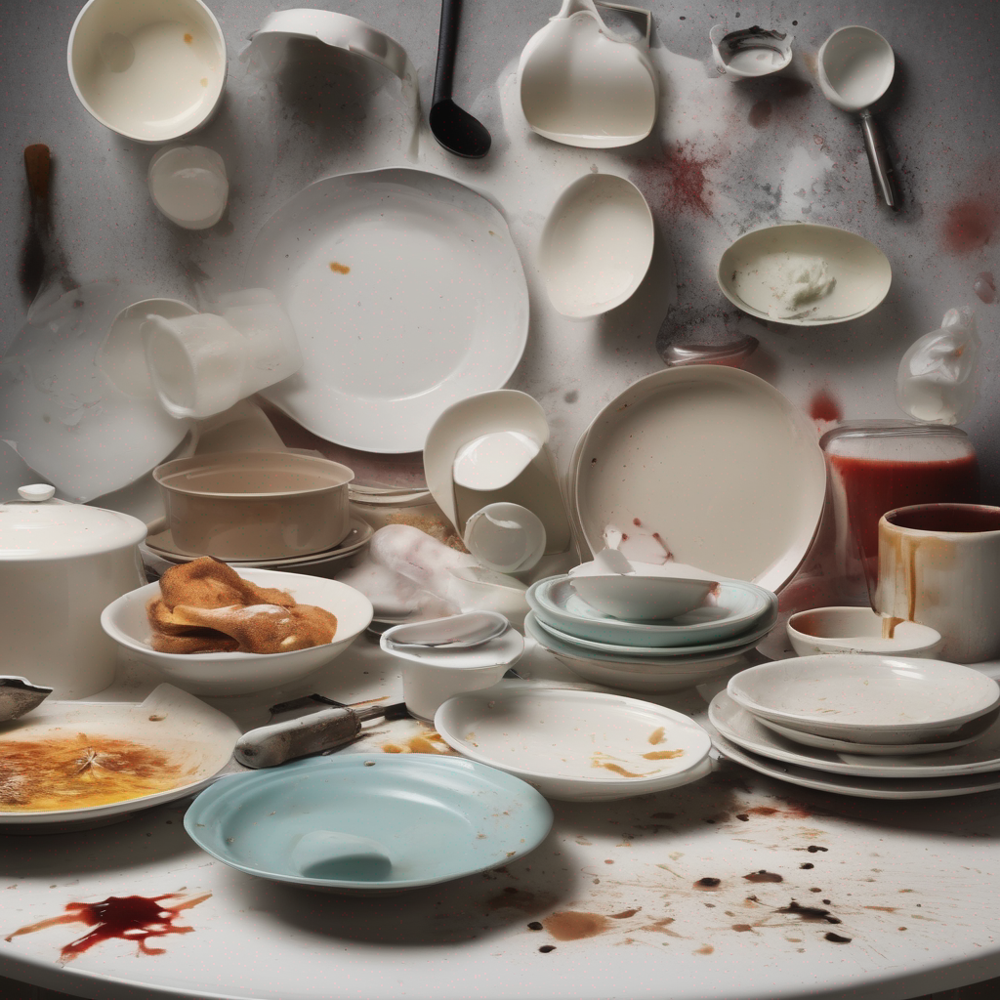

In [19]:
sdxl("variety of kitchenware dishes on a table, food stains, splatters of food stains being blown off the dishes")

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [00:13<00:00,  3.80it/s]


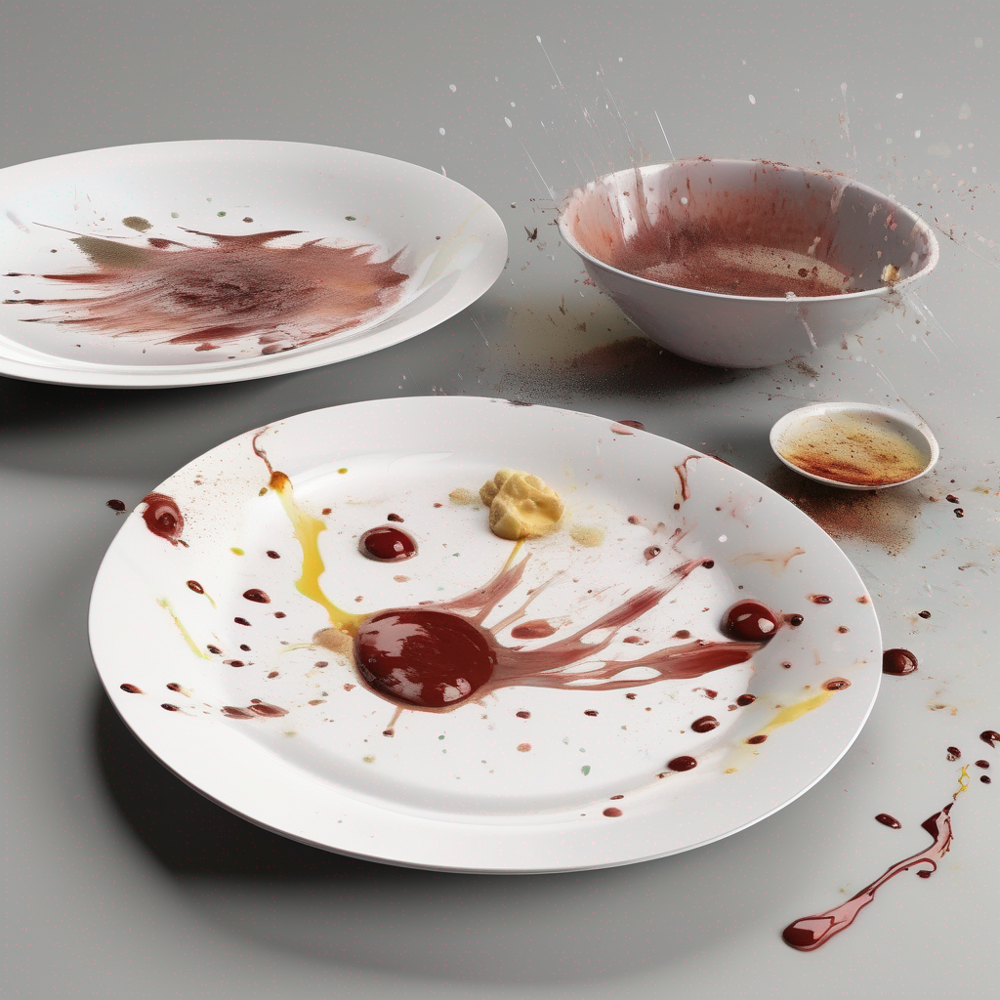

In [14]:
sdxl("Generate an image of a single plate with lifted food stains, being blown off as a result of a dish cleaning process. Showcase realistic and inventive details.")

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [00:13<00:00,  3.80it/s]


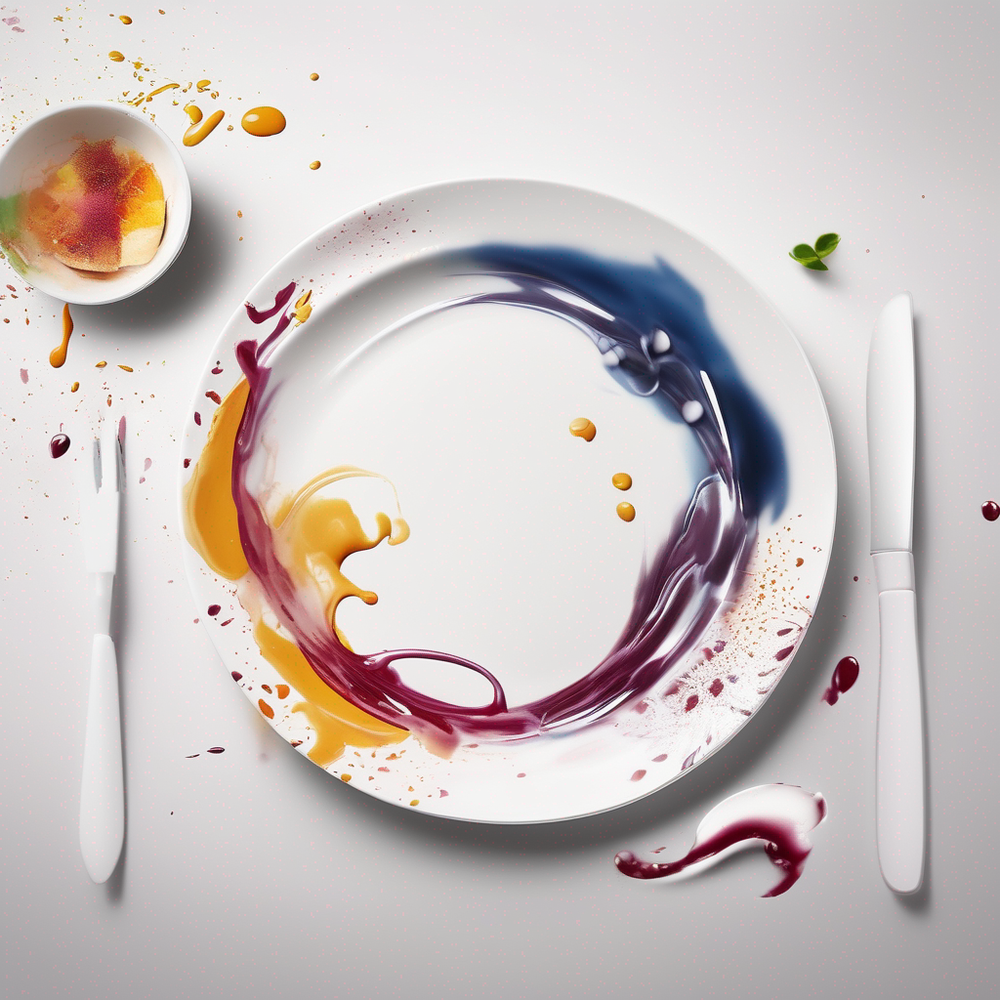

In [16]:
sdxl("Generate an image: plate with food stains magically lifted, a stunning, realistic transformation. Capture cleaning essence, infuse creativity, dynamic motion, intricate details. Depict engaging stain removal.")

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [00:13<00:00,  3.81it/s]


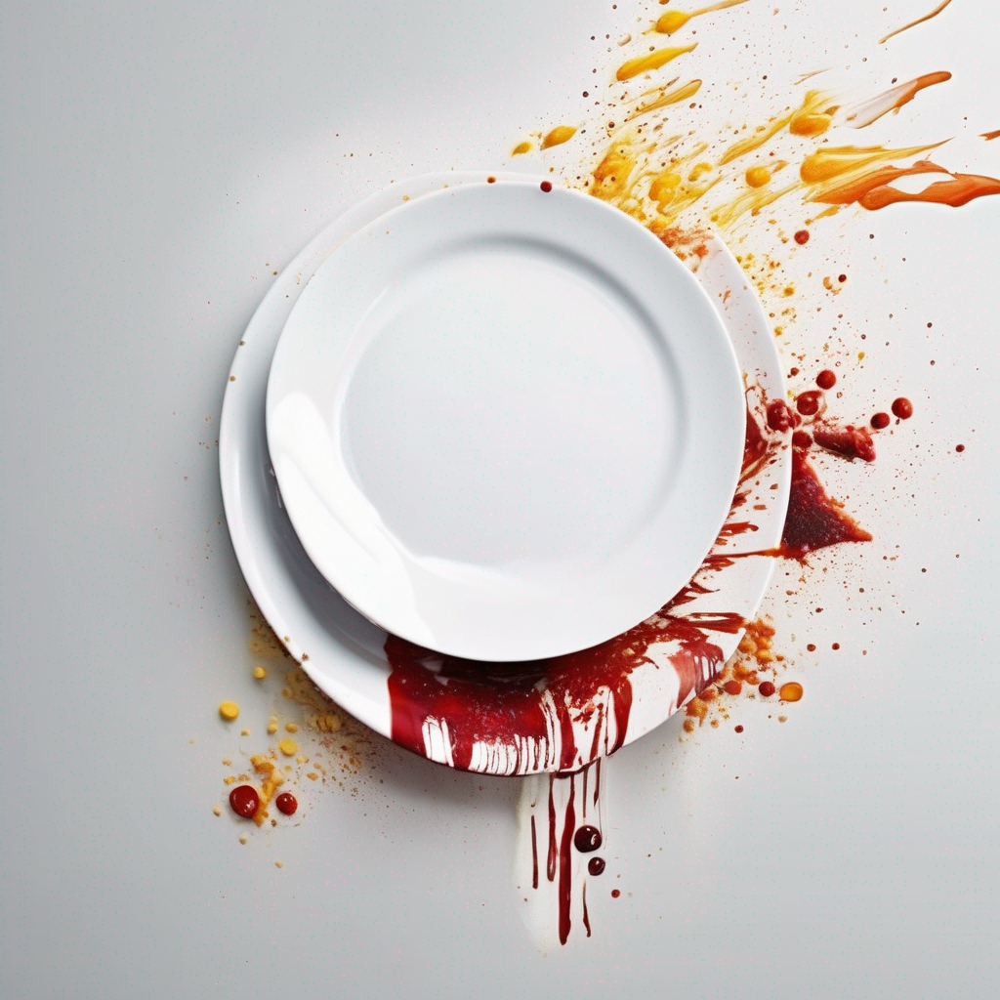

In [18]:
sdxl("Create an engaging image: a singular stack of plates with food stains lifting off them, as if blown off during a dynamic cleaning process. Realistic but creative. Ideal for marketing dishwasher tablets.")

100%|██████████| 50/50 [00:13<00:00,  3.81it/s]


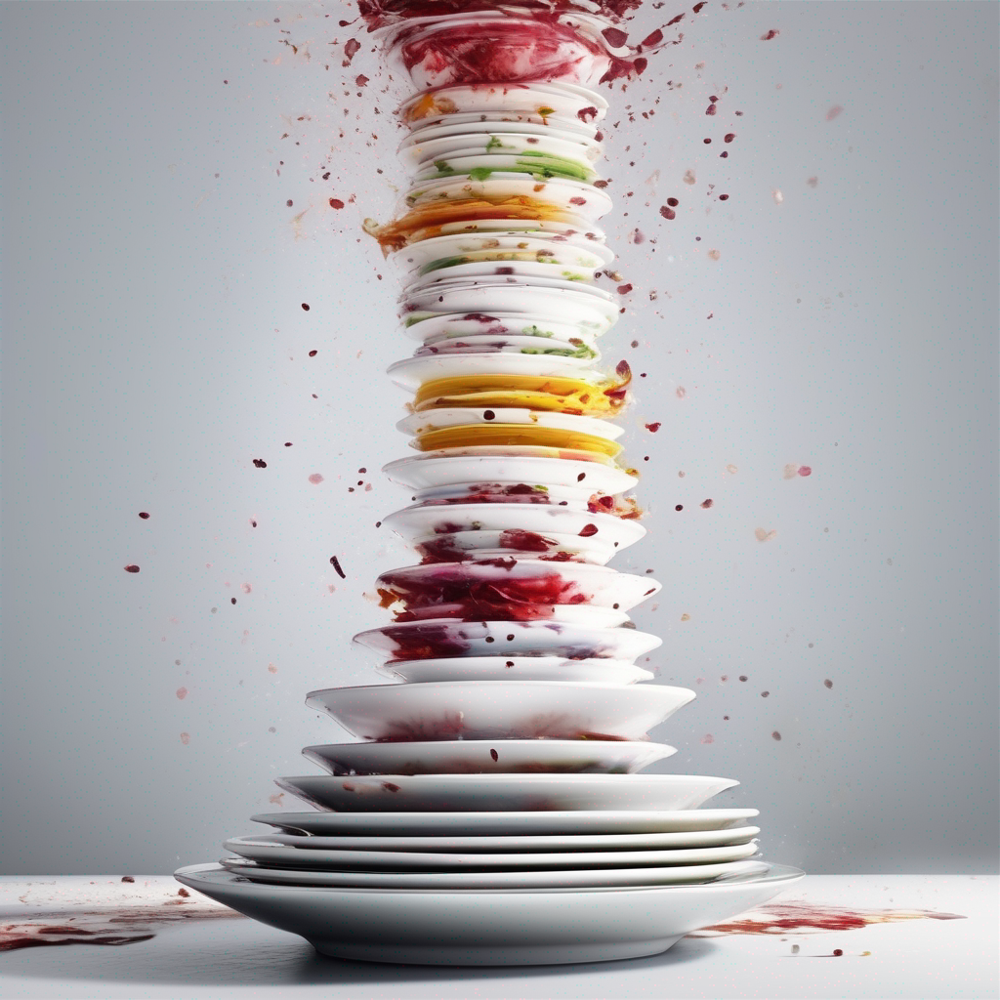

In [19]:
sdxl("Create an engaging image: plates stacked with food stains magically lifted, as if blown off during a dynamic cleaning process. Realistic but creative. Ideal for marketing dishwasher tablets.")

  2%|▏         | 1/50 [00:00<00:13,  3.61it/s]

100%|██████████| 50/50 [00:13<00:00,  3.80it/s]


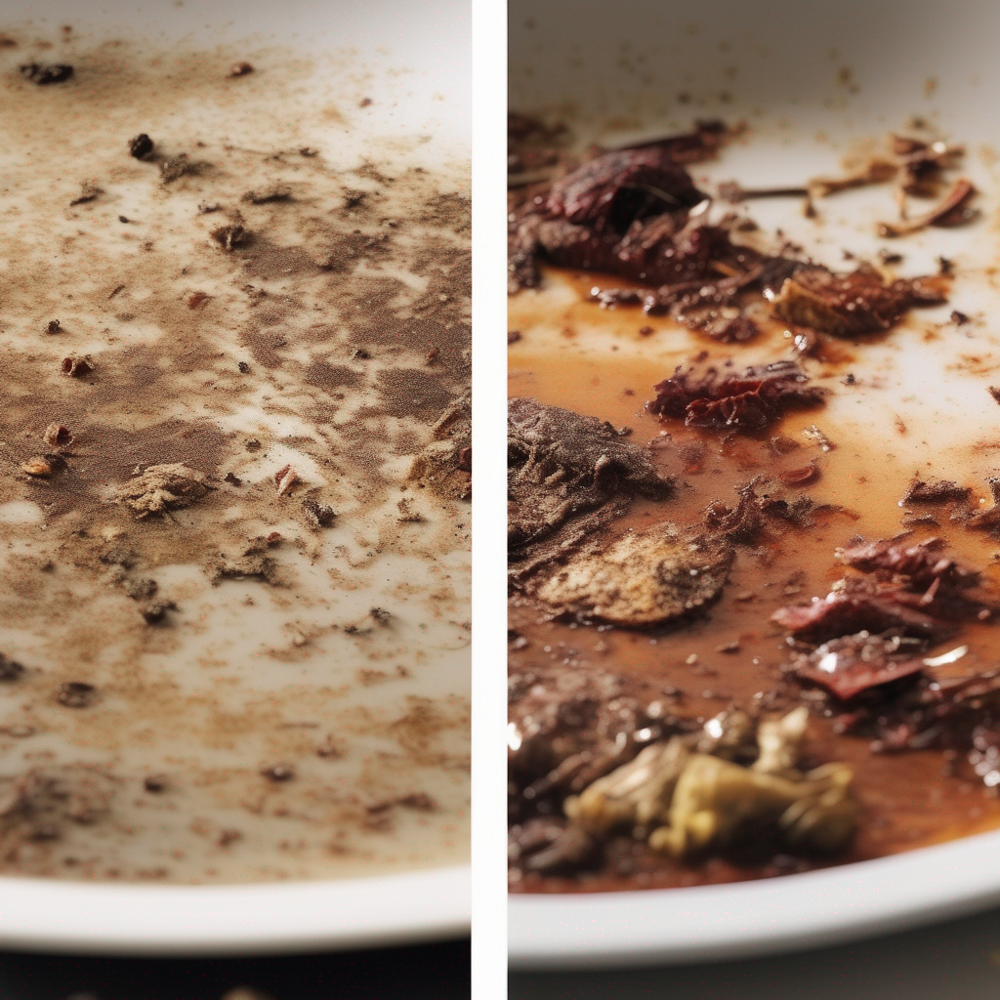

In [21]:
sdxl("close-up of a dirty, stained plate before and after it goes through the dishwasher. In the before shot, you see all of the dried and caked-on bits of food and sauce. In the after shot, the plate is pristine and gleaming.")

100%|██████████| 50/50 [00:15<00:00,  3.29it/s]


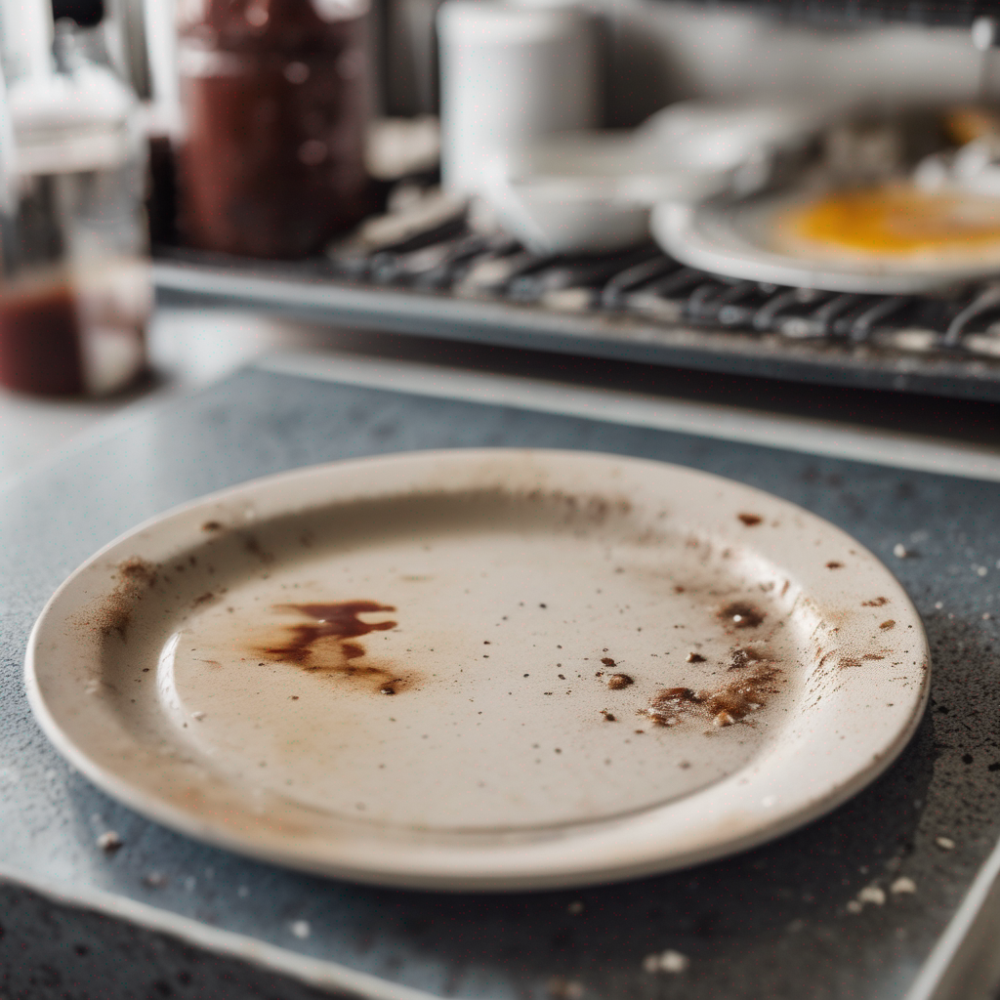

AttributeError: 'NoneType' object has no attribute 'images'

In [23]:
sdxl("close-up of a dirty, stained plate before and after it goes through the dishwasher. In the before shot, you see all of the dried and caked-on bits of food and sauce. In the after shot, the plate is clean, pristine and gleaming.").images[0]

100%|██████████| 50/50 [00:15<00:00,  3.33it/s]


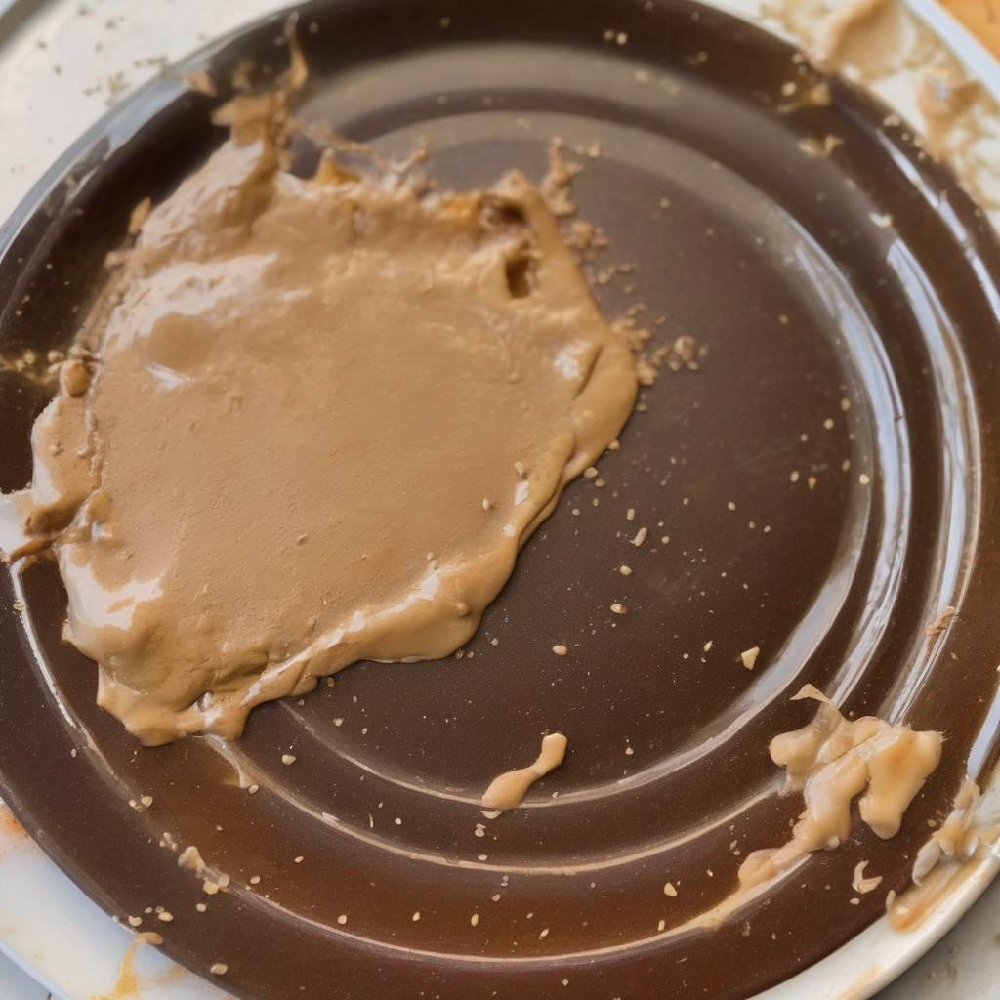

In [26]:
sdxl("close-up of a dirty, stained plate before and after it goes through the dishwasher. In the before shot, you see all of the dried and caked-on bits of food and sauce. In the after shot, the plate is clean, pristine and gleaming.")

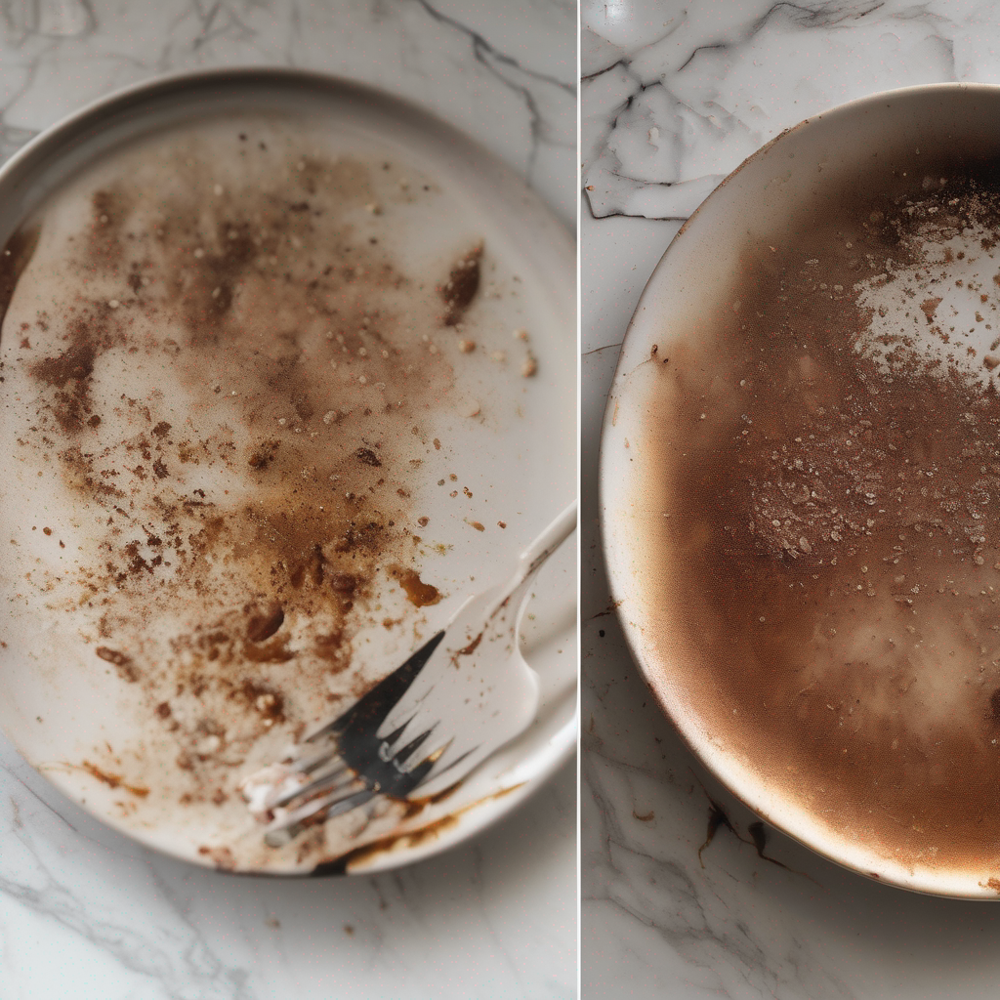

In [11]:
display(base_img1)

100%|██████████| 50/50 [00:13<00:00,  3.80it/s]


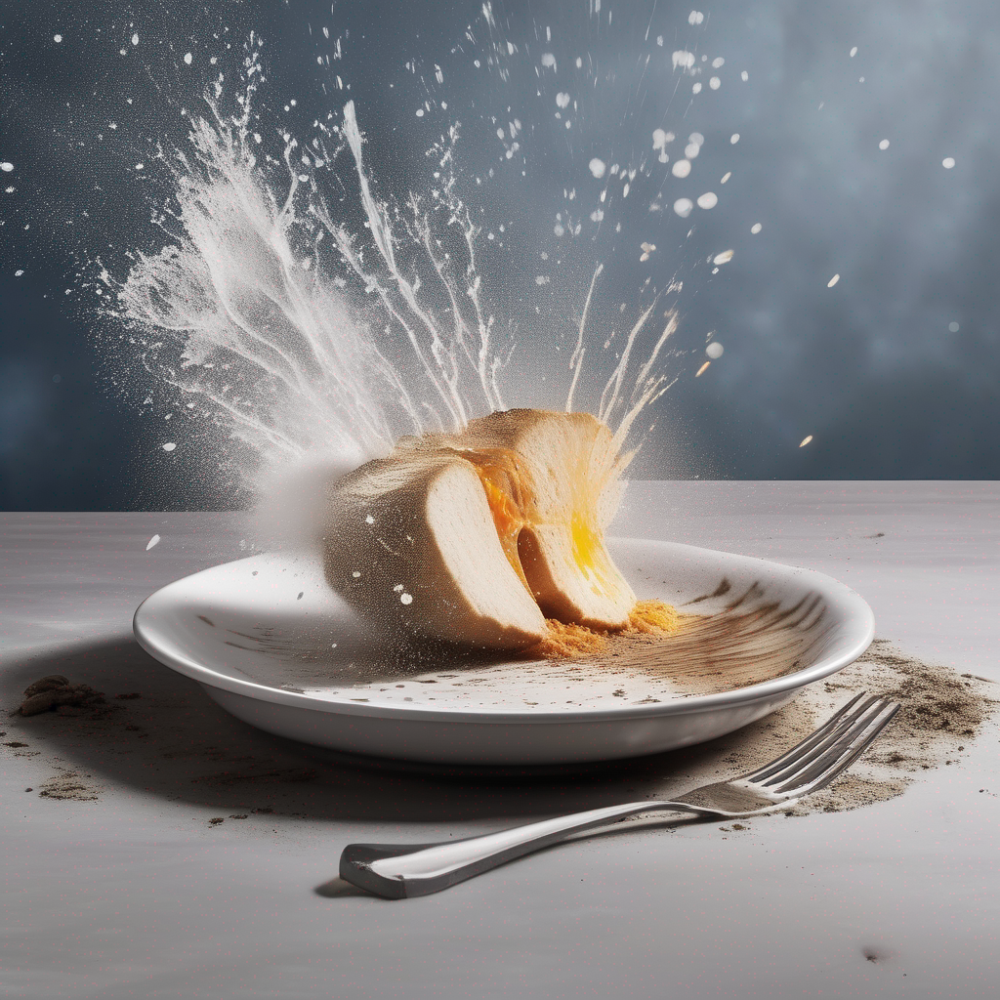

In [22]:
sdxl("Create a photo that shows a beam of high pressure splashing water hitting a dirty dinner plate, with the dirt being blasted off")

100%|██████████| 50/50 [00:13<00:00,  3.80it/s]


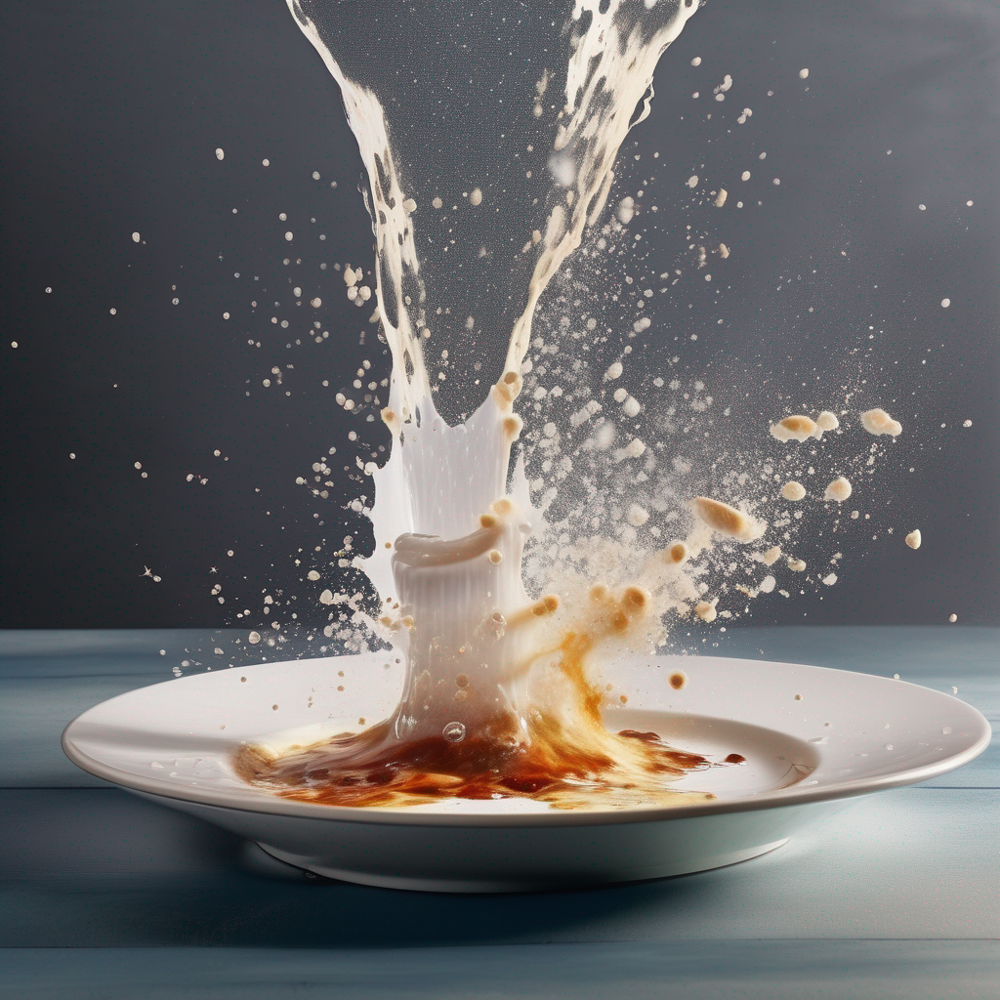

In [24]:
sdxl("Create a photo that shows a beam of high pressure splashing water hitting a plate stained with food, with the stains being blasted off.")

100%|██████████| 50/50 [00:13<00:00,  3.80it/s]


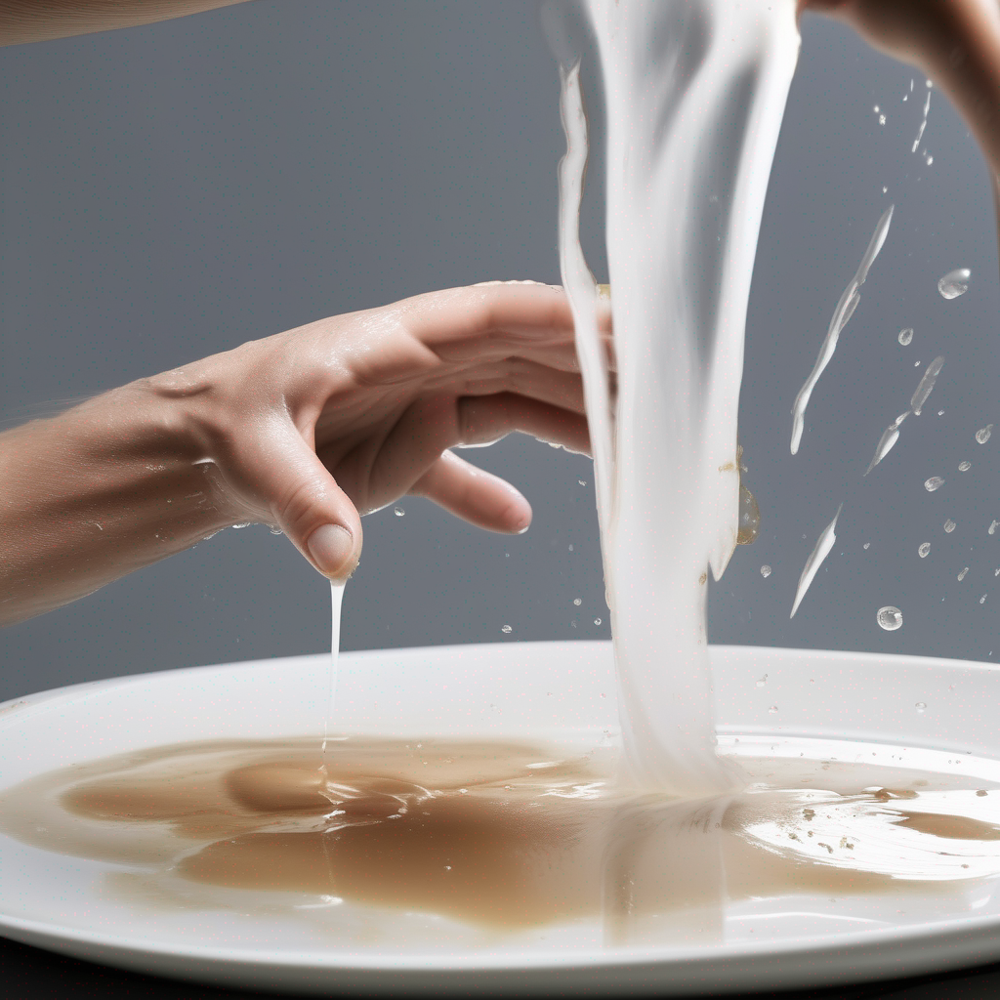

In [25]:
sdxl("create a photo of greasy stains being lifted from a white plate when a jet of water hits it")

100%|██████████| 50/50 [00:13<00:00,  3.80it/s]


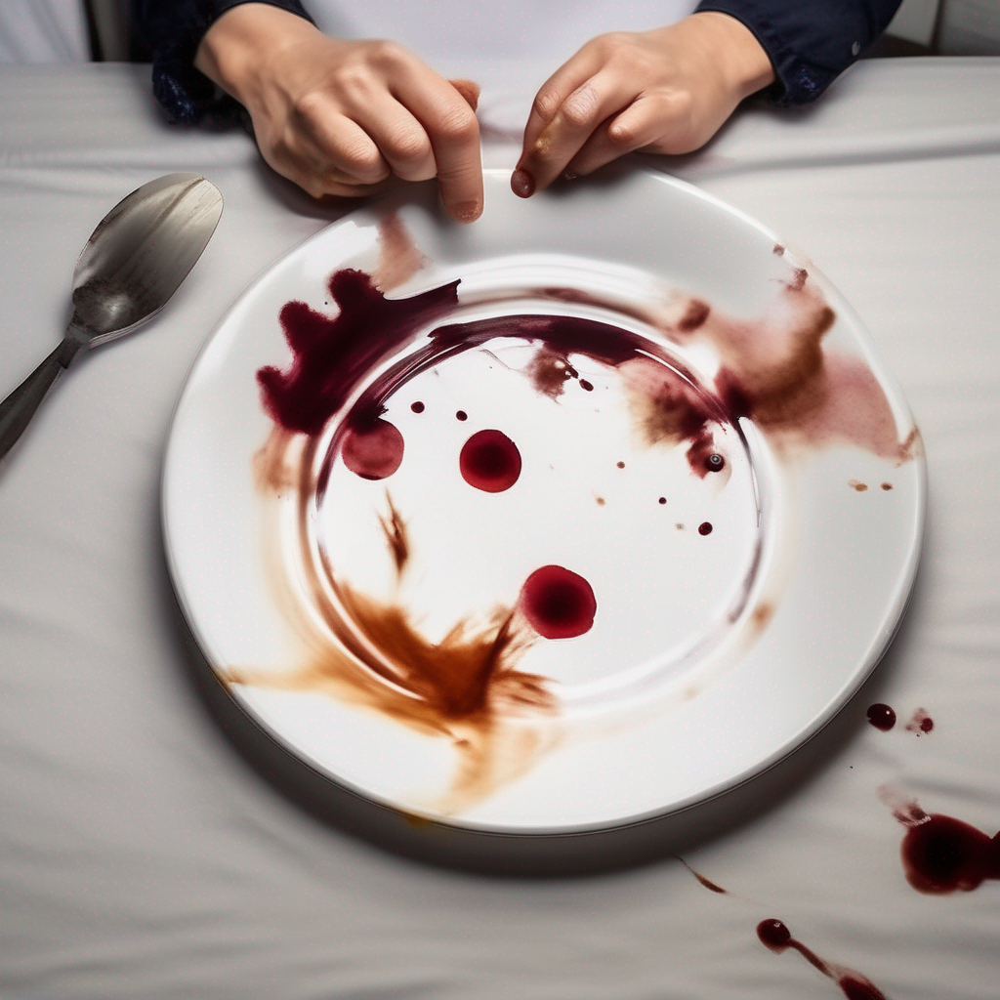

In [26]:
sdxl("Create a photo of the moment stains get lifted from a plate. Stains will look like they are suspended in the air, and the plate below is now clean and shiny")

In [28]:
p = "Create a photo of the moment stains get lifted from a plate. Stains will look like they are suspended in the air, and the plate below is now clean and shiny"
neg_p = "people"
img_neg = base(prompt=p, negative_prompt=neg_p).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [00:13<00:00,  3.80it/s]


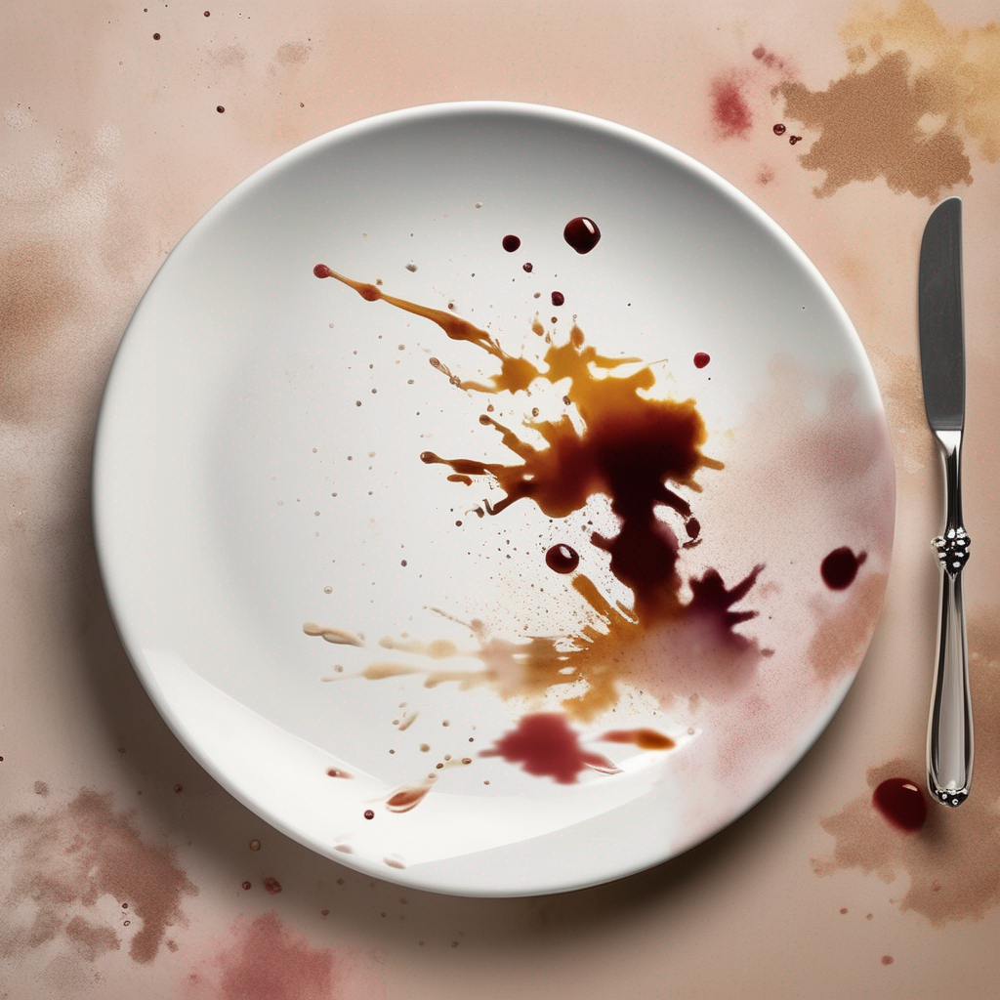

In [29]:
display(img_neg)

In [ ]:
sdxl("birds eye view from inside the dishwasher while the door is closed, cleaning cycle is in process")

# Using Parameters

In [ ]:
# pipeline_sdxl = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-0.9", torch_dtype=torch.float16, use_safetensors=True, variant="fp16")
# pipeline_sdxl.to("cuda")

In [ ]:
# g_cuda = torch.Generator(device='cuda')
# seed = 52362
# g_cuda.manual_seed(seed)

In [ ]:
# def sdxl_model(prompt, negative_prompt, num_imgs, num_inference, guidance):
#     images = pipeline_sdxl(
#         prompt=prompt,
#         height=512, # default
#         width=512, # default
#         negative_prompt=negative_prompt,
#         num_images_per_prompt=num_imgs,
#         num_inference_steps=num_inference, # default is 50 - number of denoising steps. more steps == higher quality image, slower inference
#         guidance_scale=guidance, # default is 7.5 (higher - closer to prompt but lower quality image)
#         generator=g_cuda
#     ).images
#     return images

In [ ]:
# images = sdxl_model("view of the inside of a dishwasher, cleanliness, white shiny dishes, clean water with a little foam, splashes of clear, clear water, stains removed, metal, blue background",
#                "",
#                4,
#                50,
#                7.5)

In [ ]:
# for img in images:
#     display(img)